# Reconstruction of a k-twisted strip using an Autoencoder

This notebook does the following:

1. Defines a parameterized Möbius strip
2. Trains different autoencoders of varying complexity
3. Analyzes the performance of the autoencoders and looks for singularities in the latent space
4. Custom trains an autoencoder to avoid singularities
5. Analyzes the stability the custom autoencoder
6. Tests different loss functions
7. Perturbs latent space singularities

In [1]:
import torch 
import torch.nn as nn
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import plotly.graph_objects as go
from plotly.subplots import make_subplots
from scipy.optimize import fsolve
import copy
import torch.optim as optim
import os
import time


In [2]:
enable_3d_graphics = True # Set to False if performance drops

# 1. Defining the k-twisted strip

In [3]:
class Moebius_strip(): # k-twsited möbius strip
    def __init__(self, r, w, k):
        # Initialize the parameters of the mobius strip
        self.r = r # radius of the main circle
        self.w = w # width of the strip
        self.k = k # number of twists
        
    def parameterize_circle(self,t): # Defines the C(t) function
        return np.array([self.r * np.cos(2 * np.pi * t), self.r * np.sin(2 * np.pi * t), 0])

    def parameterize_mobius_strip(self, t, s): # Defines the M(t,s) function 
        C_t = self.parameterize_circle(t)
        R_ts = (s * np.cos(self.k * np.pi * t)) * C_t + (s * np.sin(self.k * np.pi * t)) * np.array([0, 0, 1])
        M_ts = C_t + R_ts
        return M_ts

    def points_mesh_grid(self, n, include_s_t = False, seed = 123): # Returns a mesh of points on the möbius strip
        np.random.seed(seed)
        
        # Generate a grid of points
        t_values = np.linspace(0, 1, n)
        s_values = np.linspace(-self.w  / 2, self.w  / 2, n)
        T, S = np.meshgrid(t_values, s_values)

        # Compute the möbius strip coordinates
        mobius_strip = np.array([self.parameterize_mobius_strip(t, s) for t, s in zip(T.flatten(), S.flatten())])
        X, Y, Z = mobius_strip[:, 0], mobius_strip[:, 1], mobius_strip[:, 2]
        if include_s_t:
            return X, Y, Z, T, S
        return X, Y, Z

    def random_points(self, n, include_s_t = False, seed = 123): # Returns n random points on the möbius strip
        np.random.seed(seed)

        # Generate n random points
        t_values = np.random.uniform(0, 1, n)
        s_values = np.random.uniform(-self.w  / 2, self.w  / 2, n)
        
        # Compute the möbius strip coordinates
        mobius_strip = np.array([self.parameterize_mobius_strip(t, s) for t, s in zip(t_values, s_values)])
        X, Y, Z = mobius_strip[:, 0], mobius_strip[:, 1], mobius_strip[:, 2]
        if include_s_t:
            return X, Y, Z, t_values, s_values
        return X, Y, Z

# Generating the Dataset 

In [4]:
#num_twists = [0,1,2]
n = 1000
r = 1    # radius of the main circle
w = 1    # width of the strip

# Naming scheme for data as a variable X_0, Y_0, Z_0, X_1, Y_1, Z_1, ...
# The number refers to the number of twists

mobius_strip = Moebius_strip(r, w, 0)
X_0, Y_0, Z_0, T_0, S_0 = mobius_strip.random_points(n, seed = 123, include_s_t = True)
X_0 = torch.tensor(X_0, dtype=torch.float32)
Y_0 = torch.tensor(Y_0, dtype=torch.float32)
Z_0 = torch.tensor(Z_0, dtype=torch.float32)
T_0 = torch.tensor(T_0, dtype=torch.float32)
S_0 = torch.tensor(S_0, dtype=torch.float32)

mobius_strip = Moebius_strip(r, w, 1)
X_1, Y_1, Z_1, T_1, S_1 = mobius_strip.random_points(n, seed = 123, include_s_t = True)
X_1 = torch.tensor(X_1, dtype=torch.float32)
Y_1 = torch.tensor(Y_1, dtype=torch.float32)
Z_1 = torch.tensor(Z_1, dtype=torch.float32)
T_1 = torch.tensor(T_1, dtype=torch.float32)
S_1 = torch.tensor(S_1, dtype=torch.float32)

mobius_strip = Moebius_strip(r, w, 2)
X_2, Y_2, Z_2, T_2, S_2 = mobius_strip.random_points(n, seed = 123, include_s_t = True)
X_2 = torch.tensor(X_2, dtype=torch.float32)
Y_2 = torch.tensor(Y_2, dtype=torch.float32)
Z_2 = torch.tensor(Z_2, dtype=torch.float32)
T_2 = torch.tensor(T_2, dtype=torch.float32)
S_2 = torch.tensor(S_2, dtype=torch.float32)

In [5]:
if enable_3d_graphics:
    fig = make_subplots(rows=1, cols=3,
                        specs=[[{'type': 'scatter3d'}, {'type': 'scatter3d'}, {'type': 'scatter3d'}]],
                        subplot_titles=('0 twists', '1 twist', '2 twists'))

    fig.add_trace(go.Scatter3d(x=X_0, y=Y_0, z=Z_0, mode='markers', marker=dict(size=2)), row=1, col=1)
    fig.add_trace(go.Scatter3d(x=X_1, y=Y_1, z=Z_1, mode='markers', marker=dict(size=2)), row=1, col=2)
    fig.add_trace(go.Scatter3d(x=X_2, y=Y_2, z=Z_2, mode='markers', marker=dict(size=2)), row=1, col=3)

    fig.show()

# 2. Defining the Autoencoders

In [6]:
class Autoencoder_low_complexity(nn.Module):
    def __init__(self, latent_dim=2, input_dim=3):
        super(Autoencoder_low_complexity, self).__init__()
        self.encoder = nn.Sequential(
            nn.Linear(input_dim, 16),
            nn.Linear(16, 8),
            nn.Tanh(),
            nn.Linear(8, latent_dim)
        )
        self.decoder = nn.Sequential(
            nn.Linear(latent_dim, 8),
            nn.Tanh(),
            nn.Linear(8, 16),
            nn.Linear(16, input_dim),
        )

    def forward(self, x):
        x = self.encoder(x)
        x = self.decoder(x)
        return x

In [7]:
class Autoencoder_medium_complexity(nn.Module):
    def __init__(self, latent_dim=2, input_dim=3):
        super(Autoencoder_medium_complexity, self).__init__()
        self.encoder = nn.Sequential(
                    nn.Linear(input_dim, 64),
                    nn.Linear(64, 32),
                    nn.Linear(32, 16),
                    nn.Tanh(),
                    nn.Linear(16, latent_dim),
                )
        self.decoder = nn.Sequential(
                    nn.Linear(latent_dim, 16),
                    nn.Tanh(),
                    nn.Linear(16, 32),
                    nn.Linear(32, 64),
                    nn.Linear(64, input_dim),
                )

    def forward(self, x):
        x = self.encoder(x)
        x = self.decoder(x)
        return x
    


In [8]:
class Autoencoder_high_complexity(nn.Module):
    def __init__(self, latent_dim=2, input_dim=3):
        super(Autoencoder_high_complexity, self).__init__()
        self.encoder = nn.Sequential(
                    nn.Linear(input_dim, 128),
                    nn.Linear(128, 64),
                    nn.Linear(64, 32),
                    nn.Linear(32, 16),
                    nn.Tanh(),
                    nn.Linear(16, latent_dim),
                )
        self.decoder = nn.Sequential(
                    nn.Linear(latent_dim, 16),
                    nn.Tanh(),
                    nn.Linear(16, 32),
                    nn.Linear(32, 64),
                    nn.Linear(64, 128),
                    nn.Linear(128, input_dim),
                )

    def forward(self, x):
        x = self.encoder(x)
        x = self.decoder(x)
        return x

# Training 

### Training function 

In [9]:
def train_autoencoder(model, X, Y, Z, n_epochs, optimizer, device = 'cpu'):
    # Concatenate the input data
    data = torch.stack((X, Y, Z), dim=1).to(device)
    loss_values = []
    model.to(device)
    # Initialize the loss function
    criterion = nn.MSELoss()

    # To keep track of the minimum loss value and the epoch at which it occurred
    min_loss = float('inf')
    min_loss_epoch = 0

    # Training loop
    for epoch in range(n_epochs):
        # Forward pass
        outputs = model(data)
        loss = criterion(outputs, data)

        # Backward pass and optimization
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        
        # Save the loss
        loss_values.append(loss.item())
        
        # Check if the loss has decreased
        if loss.item() < min_loss:
            min_loss = loss.item()
            min_loss_epoch = epoch
        
        # Print the loss
        if epoch % 10000 == 0:
            print(f'Epoch {epoch + 1}/{n_epochs}, Loss: {loss.item()}')

    return model, loss_values

In [10]:
torch.cuda.is_available()

True

In [11]:
# Defining the model and parameters: 
latent_dim = 2
input_dim = 3
n_epochs = 5000
learning_rates = [0.001, 0.0001]
betas1 = [0.9, 0.85, 0.95]
betas2 = [0.999, 0.99, 0.995]
epsilon = 1e-8



In [12]:
train = True # Set to True to train and delete the saved weights to retrain

time_zero = time.time()
first_itr = True

device = torch.device("cuda")
device = torch.device("cpu") # comment this line to use the GPU

if train:
    for lr in learning_rates:
        for beta1 in betas1:
            for beta2 in betas2:
                # Low complexity, 0 twists
                filename = f'saved_weights/low_complexity_0_twists_{n_epochs}_{lr}_{beta1}_{beta2}.pt'
                if not os.path.exists(filename):
                    autoencoder_low_complexity = Autoencoder_low_complexity(latent_dim, input_dim).to(device)
                    optimizer = optim.Adam(autoencoder_low_complexity.parameters(), lr=lr, betas=(beta1, beta2), eps=epsilon)
                    model, loss_values = train_autoencoder(autoencoder_low_complexity, X_0, Y_0, Z_0, n_epochs, optimizer, device)
                    torch.save(model.state_dict(), filename)
                    np.save(f'saved_weights/loss_values_low_complexity_0_twists_{n_epochs}_{lr}_{beta1}_{beta2}.npy', loss_values)

                # Low complexity, 1 twist
                filename = f'saved_weights/low_complexity_1_twists_{n_epochs}_{lr}_{beta1}_{beta2}.pt'
                if not os.path.exists(filename):
                    autoencoder_low_complexity = Autoencoder_low_complexity(latent_dim, input_dim).to(device)
                    optimizer = optim.Adam(autoencoder_low_complexity.parameters(), lr=lr, betas=(beta1, beta2), eps=epsilon)
                    model, loss_values = train_autoencoder(autoencoder_low_complexity, X_1, Y_1, Z_1, n_epochs, optimizer, device)
                    torch.save(model.state_dict(), filename)
                    np.save(f'saved_weights/loss_values_low_complexity_1_twists_{n_epochs}_{lr}_{beta1}_{beta2}.npy', loss_values)

                # Low complexity, 2 twists
                filename = f'saved_weights/low_complexity_2_twists_{n_epochs}_{lr}_{beta1}_{beta2}.pt'
                if not os.path.exists(filename):
                    autoencoder_low_complexity = Autoencoder_low_complexity(latent_dim, input_dim).to(device)
                    optimizer = optim.Adam(autoencoder_low_complexity.parameters(), lr=lr, betas=(beta1, beta2), eps=epsilon)
                    model, loss_values = train_autoencoder(autoencoder_low_complexity, X_2, Y_2, Z_2, n_epochs, optimizer, device)
                    torch.save(model.state_dict(), filename)
                    np.save(f'saved_weights/loss_values_low_complexity_2_twists_{n_epochs}_{lr}_{beta1}_{beta2}.npy', loss_values)

                # Medium complexity, 0 twists
                filename = f'saved_weights/medium_complexity_0_twists_{n_epochs}_{lr}_{beta1}_{beta2}.pt'
                if not os.path.exists(filename):
                    autoencoder_medium_complexity = Autoencoder_medium_complexity(latent_dim, input_dim).to(device)
                    optimizer = optim.Adam(autoencoder_medium_complexity.parameters(), lr=lr, betas=(beta1, beta2), eps=epsilon)
                    model, loss_values = train_autoencoder(autoencoder_medium_complexity, X_0, Y_0, Z_0, n_epochs, optimizer, device)
                    torch.save(model.state_dict(), filename)
                    np.save(f'saved_weights/loss_values_medium_complexity_0_twists_{n_epochs}_{lr}_{beta1}_{beta2}.npy', loss_values)

                # Medium complexity, 1 twist
                filename = f'saved_weights/medium_complexity_1_twists_{n_epochs}_{lr}_{beta1}_{beta2}.pt'
                if not os.path.exists(filename):
                    autoencoder_medium_complexity = Autoencoder_medium_complexity(latent_dim, input_dim).to(device)
                    optimizer = optim.Adam(autoencoder_medium_complexity.parameters(), lr=lr, betas=(beta1, beta2), eps=epsilon)
                    model, loss_values = train_autoencoder(autoencoder_medium_complexity, X_1, Y_1, Z_1, n_epochs, optimizer, device)
                    torch.save(model.state_dict(), filename)
                    np.save(f'saved_weights/loss_values_medium_complexity_1_twists_{n_epochs}_{lr}_{beta1}_{beta2}.npy', loss_values)

                # Medium complexity, 2 twists
                filename = f'saved_weights/medium_complexity_2_twists_{n_epochs}_{lr}_{beta1}_{beta2}.pt'
                if not os.path.exists(filename):
                    autoencoder_medium_complexity = Autoencoder_medium_complexity(latent_dim, input_dim).to(device)
                    optimizer = optim.Adam(autoencoder_medium_complexity.parameters(), lr=lr, betas=(beta1, beta2), eps=epsilon)
                    model, loss_values = train_autoencoder(autoencoder_medium_complexity, X_2, Y_2, Z_2, n_epochs, optimizer, device)
                    torch.save(model.state_dict(), filename)
                    np.save(f'saved_weights/loss_values_medium_complexity_2_twists_{n_epochs}_{lr}_{beta1}_{beta2}.npy', loss_values)

                # High complexity, 0 twists
                filename = f'saved_weights/high_complexity_0_twists_{n_epochs}_{lr}_{beta1}_{beta2}.pt'
                if not os.path.exists(filename):
                    autoencoder_high_complexity = Autoencoder_high_complexity(latent_dim, input_dim).to(device)
                    optimizer = optim.Adam(autoencoder_high_complexity.parameters(), lr=lr, betas=(beta1, beta2), eps=epsilon)
                    model, loss_values = train_autoencoder(autoencoder_high_complexity, X_0, Y_0, Z_0, n_epochs, optimizer, device)
                    torch.save(model.state_dict(), filename)
                    np.save(f'saved_weights/loss_values_high_complexity_0_twists_{n_epochs}_{lr}_{beta1}_{beta2}.npy', loss_values)

                # High complexity, 1 twist
                filename = f'saved_weights/high_complexity_1_twists_{n_epochs}_{lr}_{beta1}_{beta2}.pt'
                if not os.path.exists(filename):
                    autoencoder_high_complexity = Autoencoder_high_complexity(latent_dim, input_dim).to(device)
                    optimizer = optim.Adam(autoencoder_high_complexity.parameters(), lr=lr, betas=(beta1, beta2), eps=epsilon)
                    model, loss_values = train_autoencoder(autoencoder_high_complexity, X_1, Y_1, Z_1, n_epochs, optimizer, device)
                    torch.save(model.state_dict(), filename)
                    np.save(f'saved_weights/loss_values_high_complexity_1_twists_{n_epochs}_{lr}_{beta1}_{beta2}.npy', loss_values)

                # High complexity, 2 twists
                filename = f'saved_weights/high_complexity_2_twists_{n_epochs}_{lr}_{beta1}_{beta2}.pt'
                if not os.path.exists(filename):
                    autoencoder_high_complexity = Autoencoder_high_complexity(latent_dim, input_dim).to(device)
                    optimizer = optim.Adam(autoencoder_high_complexity.parameters(), lr=lr, betas=(beta1, beta2), eps=epsilon)
                    model, loss_values = train_autoencoder(autoencoder_high_complexity, X_2, Y_2, Z_2, n_epochs, optimizer, device)
                    torch.save(model.state_dict(), filename)
                    np.save(f'saved_weights/loss_values_high_complexity_2_twists_{n_epochs}_{lr}_{beta1}_{beta2}.npy', loss_values)

                if first_itr:
                    first_itr = False
                    time_one = time.time()

                    diff = time_one - time_zero
                    lrs = len(learning_rates)
                    beta_ones = len(betas1)
                    beta_twos = len(betas2)

                    estimated_time_hours = (diff * lrs * beta_ones * beta_twos) / 3600
                    print("Estimated time in hrs:", estimated_time_hours)


Estimated time in hrs: 7.978558540344238e-05


In [27]:
import torch
import numpy as np

#device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
device = torch.device('cpu')
loss_cuttoff = 30000  # for plotting
loss_skip = 100  # for plotting

# Load the weights and loss values
# naming scheme: model_complexity_n_twists_n_epochs_lr_beta1_beta2
# naming scheme for loss_values: loss_values_complexity_n_twists_n_epochs_lr_beta1_beta2

model_low_complexity_0_twists = []
loss_values_low_complexity_0_twists = []

model_low_complexity_1_twists = []
loss_values_low_complexity_1_twists = []

model_low_complexity_2_twists = []
loss_values_low_complexity_2_twists = []

model_medium_complexity_0_twists = []
loss_values_medium_complexity_0_twists = []

model_medium_complexity_1_twists = []
loss_values_medium_complexity_1_twists = []

model_medium_complexity_2_twists = []
loss_values_medium_complexity_2_twists = []

model_high_complexity_0_twists = []
loss_values_high_complexity_0_twists = []

model_high_complexity_1_twists = []
loss_values_high_complexity_1_twists = []

model_high_complexity_2_twists = []
loss_values_high_complexity_2_twists = []

for lr in learning_rates:
    for beta1 in betas1:
        for beta2 in betas2:
            # Low complexity, 0 twists
            model = Autoencoder_low_complexity(latent_dim, input_dim).to(device)
            model.load_state_dict(torch.load(f'saved_weights/low_complexity_0_twists_{n_epochs}_{lr}_{beta1}_{beta2}.pt', map_location=device))
            model_low_complexity_0_twists.append(model)
            loss_values = np.load(f'saved_weights/loss_values_low_complexity_0_twists_{n_epochs}_{lr}_{beta1}_{beta2}.npy')
            loss_values = loss_values[:loss_cuttoff:loss_skip]
            loss_values_low_complexity_0_twists.append(loss_values)

            # Low complexity, 1 twist
            model = Autoencoder_low_complexity(latent_dim, input_dim).to(device)
            model.load_state_dict(torch.load(f'saved_weights/low_complexity_1_twists_{n_epochs}_{lr}_{beta1}_{beta2}.pt', map_location=device))
            model_low_complexity_1_twists.append(model)
            loss_values = np.load(f'saved_weights/loss_values_low_complexity_1_twists_{n_epochs}_{lr}_{beta1}_{beta2}.npy')
            loss_values = loss_values[:loss_cuttoff:loss_skip]
            loss_values_low_complexity_1_twists.append(loss_values)

            # Low complexity, 2 twists
            model = Autoencoder_low_complexity(latent_dim, input_dim).to(device)
            model.load_state_dict(torch.load(f'saved_weights/low_complexity_2_twists_{n_epochs}_{lr}_{beta1}_{beta2}.pt', map_location=device))
            model_low_complexity_2_twists.append(model)
            loss_values = np.load(f'saved_weights/loss_values_low_complexity_2_twists_{n_epochs}_{lr}_{beta1}_{beta2}.npy')
            loss_values = loss_values[:loss_cuttoff:loss_skip]
            loss_values_low_complexity_2_twists.append(loss_values)

            # Medium complexity, 0 twists
            model = Autoencoder_medium_complexity(latent_dim, input_dim).to(device)
            model.load_state_dict(torch.load(f'saved_weights/medium_complexity_0_twists_{n_epochs}_{lr}_{beta1}_{beta2}.pt', map_location=device))
            model_medium_complexity_0_twists.append(model)
            loss_values = np.load(f'saved_weights/loss_values_medium_complexity_0_twists_{n_epochs}_{lr}_{beta1}_{beta2}.npy')
            loss_values = loss_values[:loss_cuttoff:loss_skip]
            loss_values_medium_complexity_0_twists.append(loss_values)

            # Medium complexity, 1 twist
            model = Autoencoder_medium_complexity(latent_dim, input_dim).to(device)
            model.load_state_dict(torch.load(f'saved_weights/medium_complexity_1_twists_{n_epochs}_{lr}_{beta1}_{beta2}.pt', map_location=device))
            model_medium_complexity_1_twists.append(model)
            loss_values = np.load(f'saved_weights/loss_values_medium_complexity_1_twists_{n_epochs}_{lr}_{beta1}_{beta2}.npy')
            loss_values = loss_values[:loss_cuttoff:loss_skip]
            loss_values_medium_complexity_1_twists.append(loss_values)

            # Medium complexity, 2 twists
            model = Autoencoder_medium_complexity(latent_dim, input_dim).to(device)
            model.load_state_dict(torch.load(f'saved_weights/medium_complexity_2_twists_{n_epochs}_{lr}_{beta1}_{beta2}.pt', map_location=device))
            model_medium_complexity_2_twists.append(model)
            loss_values = np.load(f'saved_weights/loss_values_medium_complexity_2_twists_{n_epochs}_{lr}_{beta1}_{beta2}.npy')
            loss_values = loss_values[:loss_cuttoff:loss_skip]
            loss_values_medium_complexity_2_twists.append(loss_values)

            # High complexity, 0 twists
            model = Autoencoder_high_complexity(latent_dim, input_dim).to(device)
            model.load_state_dict(torch.load(f'saved_weights/high_complexity_0_twists_{n_epochs}_{lr}_{beta1}_{beta2}.pt', map_location=device))
            model_high_complexity_0_twists.append(model)
            loss_values = np.load(f'saved_weights/loss_values_high_complexity_0_twists_{n_epochs}_{lr}_{beta1}_{beta2}.npy')
            loss_values = loss_values[:loss_cuttoff:loss_skip]
            loss_values_high_complexity_0_twists.append(loss_values)

            # High complexity, 1 twist
            model = Autoencoder_high_complexity(latent_dim, input_dim).to(device)
            model.load_state_dict(torch.load(f'saved_weights/high_complexity_1_twists_{n_epochs}_{lr}_{beta1}_{beta2}.pt', map_location=device))
            model_high_complexity_1_twists.append(model)
            loss_values = np.load(f'saved_weights/loss_values_high_complexity_1_twists_{n_epochs}_{lr}_{beta1}_{beta2}.npy')
            loss_values = loss_values[:loss_cuttoff:loss_skip]
            loss_values_high_complexity_1_twists.append(loss_values)

            # High complexity, 2 twists
            model = Autoencoder_high_complexity(latent_dim, input_dim).to(device)
            model.load_state_dict(torch.load(f'saved_weights/high_complexity_2_twists_{n_epochs}_{lr}_{beta1}_{beta2}.pt', map_location=device))
            model_high_complexity_2_twists.append(model)
            loss_values = np.load(f'saved_weights/loss_values_high_complexity_2_twists_{n_epochs}_{lr}_{beta1}_{beta2}.npy')
            loss_values = loss_values[:loss_cuttoff:loss_skip]
            loss_values_high_complexity_2_twists.append(loss_values)


# 3. Analysis of the models

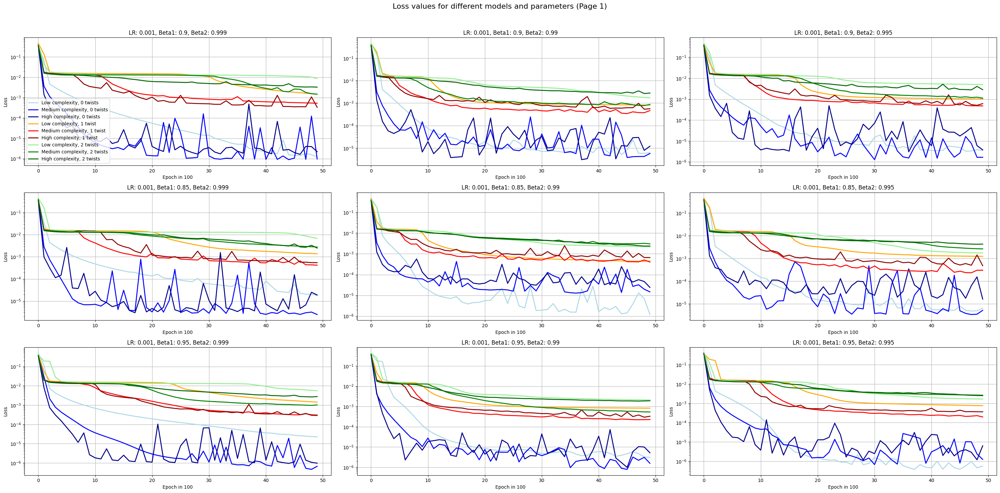

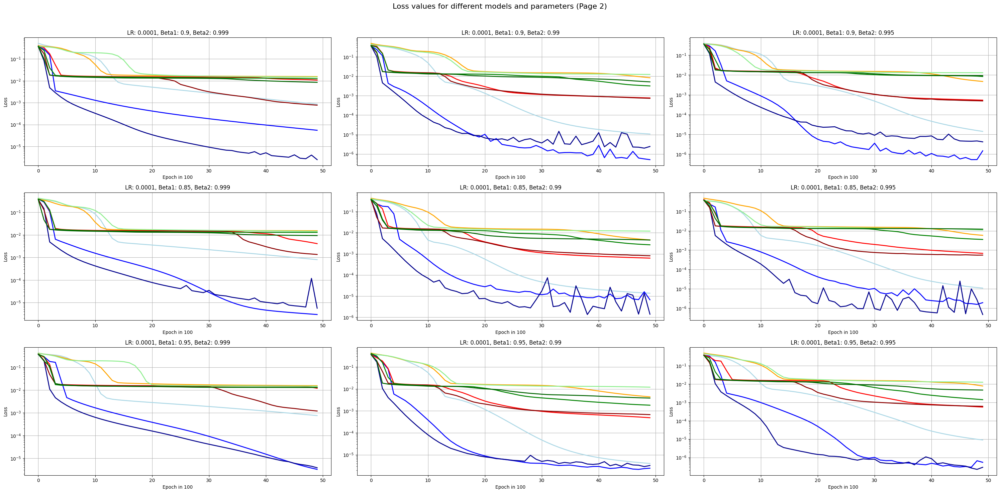

In [28]:
import matplotlib.pyplot as plt


# Total number of subplots
total_plots = len(learning_rates) * len(betas1) * len(betas2)
plots_per_page = total_plots // 2  

# Function to plot a page of plots
def plot_page(axs, start_index, end_index, include_legend=False):
    plot_counter = 0
    for i in range(start_index, end_index):
        lr = learning_rates[i // (len(betas1) * len(betas2))]
        beta1 = betas1[(i // len(betas2)) % len(betas1)]
        beta2 = betas2[i % len(betas2)]

        axs[plot_counter].plot(loss_values_low_complexity_0_twists[i], label='Low complexity, 0 twists', linewidth=2, color='lightblue')
        axs[plot_counter].plot(loss_values_medium_complexity_0_twists[i], label='Medium complexity, 0 twists', linewidth=2, color='blue')
        axs[plot_counter].plot(loss_values_high_complexity_0_twists[i], label='High complexity, 0 twists', linewidth=2, color='darkblue')

        axs[plot_counter].plot(loss_values_low_complexity_1_twists[i], label='Low complexity, 1 twist', linewidth=2, color='orange')
        axs[plot_counter].plot(loss_values_medium_complexity_1_twists[i], label='Medium complexity, 1 twist', linewidth=2, color='red')
        axs[plot_counter].plot(loss_values_high_complexity_1_twists[i], label='High complexity, 1 twist', linewidth=2, color='darkred')

        axs[plot_counter].plot(loss_values_low_complexity_2_twists[i], label='Low complexity, 2 twists', linewidth=2, color='lightgreen')
        axs[plot_counter].plot(loss_values_medium_complexity_2_twists[i], label='Medium complexity, 2 twists', linewidth=2, color='green')
        axs[plot_counter].plot(loss_values_high_complexity_2_twists[i], label='High complexity, 2 twists', linewidth=2, color='darkgreen')

        axs[plot_counter].set_title(f'LR: {lr}, Beta1: {beta1}, Beta2: {beta2}')
        axs[plot_counter].set_xlabel('Epoch in ' + str(loss_skip))
        axs[plot_counter].set_ylabel('Loss')
        axs[plot_counter].grid(True)
        axs[plot_counter].set_yscale('log')
        
        if include_legend and plot_counter == 0:  # Include legend only in the first plot of the page
            axs[plot_counter].legend()

        plot_counter += 1

# Plot the first page
fig, axs = plt.subplots(3, 3, figsize=(30, 15))
fig.suptitle('Loss values for different models and parameters (Page 1)', fontsize=16)
axs = axs.flatten()
plot_page(axs, 0, plots_per_page, include_legend=True)
plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.show()

# Plot the second page
fig, axs = plt.subplots(3, 3, figsize=(30, 15))
fig.suptitle('Loss values for different models and parameters (Page 2)', fontsize=16)
axs = axs.flatten()
plot_page(axs, plots_per_page, total_plots)
plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.show()


In [29]:
# Sorting for lowest loss values
min_losses = {
    'low': [np.inf] * 3,
    'medium': [np.inf] * 3,
    'high': [np.inf] * 3
}

best_models = {
    'low': [None] * 3,
    'medium': [None] * 3,
    'high': [None] * 3
}

loss_values = {
    'low': [loss_values_low_complexity_0_twists, loss_values_low_complexity_1_twists, loss_values_low_complexity_2_twists],
    'medium': [loss_values_medium_complexity_0_twists, loss_values_medium_complexity_1_twists, loss_values_medium_complexity_2_twists],
    'high': [loss_values_high_complexity_0_twists, loss_values_high_complexity_1_twists, loss_values_high_complexity_2_twists]
}

models = {
    'low': [model_low_complexity_0_twists, model_low_complexity_1_twists, model_low_complexity_2_twists],
    'medium': [model_medium_complexity_0_twists, model_medium_complexity_1_twists, model_medium_complexity_2_twists],
    'high': [model_high_complexity_0_twists, model_high_complexity_1_twists, model_high_complexity_2_twists]
}

lowest_loss_lr = 0
lowest_loss_beta1 = 0
lowest_loss_beta2 = 0

best_models_list = [None, None, None]

# Loop through each twist
for k in range(3):
    lowest_loss = np.inf
    best_model = None
    for complexity in ['low', 'medium', 'high']:
        for i, lr in enumerate(learning_rates):
            for j, (beta1, beta2) in enumerate(zip(betas1, betas2)):
                index = i * 3 + j
                current_loss = loss_values[complexity][k][index][-1]
                if current_loss < min_losses[complexity][k]:
                    min_losses[complexity][k] = current_loss
                    best_models[complexity][k] = models[complexity][k][index]
                if current_loss < lowest_loss:
                    lowest_loss = current_loss
                    best_model = models[complexity][k][index]
                    lowest_loss_lr = lr
                    lowest_loss_beta1 = beta1
                    lowest_loss_beta2 = beta2
    best_models_list[k] = best_model

# Print the lowest loss values for each complexity and twist
print('Lowest loss values:')
for k in range(3):
    for complexity in ['low', 'medium', 'high']:
        loss_str = f'{min_losses[complexity][k]:.2e}'
        lr_str = f'{lowest_loss_lr}'
        beta1_str = f'{lowest_loss_beta1}'
        beta2_str = f'{lowest_loss_beta2}'
        print(f'{complexity.capitalize()} complexity, {k} twists: {loss_str}, Learning rate: {lr_str}, Beta1: {beta1_str}, Beta2: {beta2_str}')
    

Lowest loss values:
Low complexity, 0 twists: 1.19e-06, Learning rate: 0.001, Beta1: 0.85, Beta2: 0.99
Medium complexity, 0 twists: 9.56e-07, Learning rate: 0.001, Beta1: 0.85, Beta2: 0.99
High complexity, 0 twists: 2.20e-06, Learning rate: 0.001, Beta1: 0.85, Beta2: 0.99
Low complexity, 1 twists: 4.52e-04, Learning rate: 0.001, Beta1: 0.85, Beta2: 0.99
Medium complexity, 1 twists: 3.00e-04, Learning rate: 0.001, Beta1: 0.85, Beta2: 0.99
High complexity, 1 twists: 3.36e-04, Learning rate: 0.001, Beta1: 0.85, Beta2: 0.99
Low complexity, 2 twists: 1.71e-03, Learning rate: 0.001, Beta1: 0.85, Beta2: 0.99
Medium complexity, 2 twists: 8.70e-04, Learning rate: 0.001, Beta1: 0.85, Beta2: 0.99
High complexity, 2 twists: 2.38e-03, Learning rate: 0.001, Beta1: 0.85, Beta2: 0.99


It seems as though there is a monotone increase from 0 twists to 2 twists regardless of model complexity. This is surprising as the 0-twisted Möbius strip is homeomorphic to the 2-twisted one; hence, we expected similar performance.



In [30]:
#Regenerating data for testing 

n_test = 10000
r = 1    # radius of the main circle
w = 1    # width of the strip

mobius_strip = Moebius_strip(r, w, 0)
X_0_test, Y_0_test, Z_0_test, S_0_test, T_0_test = mobius_strip.random_points(n_test, seed= 2024 , include_s_t = True)
X_0_test = torch.tensor(X_0_test, dtype=torch.float32)
Y_0_test = torch.tensor(Y_0_test, dtype=torch.float32)
Z_0_test = torch.tensor(Z_0_test, dtype=torch.float32)
S_0_test = torch.tensor(S_0_test, dtype=torch.float32)
T_0_test = torch.tensor(T_0_test, dtype=torch.float32)

mobius_strip = Moebius_strip(r, w, 1)
X_1_test, Y_1_test, Z_1_test, S_1_test, T_1_test = mobius_strip.random_points(n_test, seed= 2024 , include_s_t = True)
X_1_test = torch.tensor(X_1_test, dtype=torch.float32)
Y_1_test = torch.tensor(Y_1_test, dtype=torch.float32)
Z_1_test = torch.tensor(Z_1_test, dtype=torch.float32)
S_1_test = torch.tensor(S_1_test, dtype=torch.float32)
T_1_test = torch.tensor(T_1_test, dtype=torch.float32)

mobius_strip = Moebius_strip(r, w, 2)
X_2_test, Y_2_test, Z_2_test, S_2_test, T_2_test = mobius_strip.random_points(n_test, seed= 2024 , include_s_t = True)
X_2_test = torch.tensor(X_2_test, dtype=torch.float32)
Y_2_test = torch.tensor(Y_2_test, dtype=torch.float32)
Z_2_test = torch.tensor(Z_2_test, dtype=torch.float32)
S_2_test = torch.tensor(S_2_test, dtype=torch.float32)
T_2_test = torch.tensor(T_2_test, dtype=torch.float32)





In [31]:
from plotly.subplots import make_subplots
import plotly.graph_objects as go

if enable_3d_graphics:
    # Create a subplot with 1 row and 3 columns
    fig = make_subplots(rows=1, cols=3, 
                        specs=[[{'type': 'scatter3d'}, {'type': 'scatter3d'}, {'type': 'scatter3d'}]],
                        subplot_titles=('0 twists', '1 twist', '2 twists'))

    for k in range(3):
        best_model = best_models_list[k]
        data = torch.stack((eval(f'X_{k}_test'), eval(f'Y_{k}_test'), eval(f'Z_{k}_test')), dim=1).detach().to(device).cpu()
        reconstructed_data = best_model(data).to(device).cpu().detach().numpy()

        # Add original data
        fig.add_trace(
            go.Scatter3d(x=eval(f'X_{k}_test'), y=eval(f'Y_{k}_test'), z=eval(f'Z_{k}_test'),
                        mode='markers', marker=dict(size=2, color='blue'), name='Original'),
            row=1, col=k+1
        )

        # Add reconstructed data
        fig.add_trace(
            go.Scatter3d(x=reconstructed_data[:, 0], y=reconstructed_data[:, 1], z=reconstructed_data[:, 2],
                        mode='markers', marker=dict(size=2, color='red'), name='Reconstructed'),
            row=1, col=k+1
        )

    # Update layout to adjust scene aspect ratio and titles
    fig.update_layout(
        title='Best Models for Different Twists',
        height=600,
        width=1800,
        scene=dict(
            aspectmode='manual',
            aspectratio=dict(x=1, y=1, z=1),
            zaxis=dict(range=[-1, 1])
        ),
        showlegend=False
    )

    fig.show()


# Searching for singularities in the embedding, computing the derivative

In [32]:
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
import torch
import numpy as np

class ModelAnalysis: 
    def __init__(self, model, X_test, Y_test, Z_test, S_test, T_test, twists=2, use_upper_singularity_point=False): 
        self.model = model
        self.data_points = torch.stack((X_test, Y_test, Z_test), dim=1)
        self.data_s_t = torch.stack((S_test, T_test), dim=1)
        self.r = 1    # radius of the main circle
        self.w = 1    # width of the strip  
        self.k = twists    # number of twists

        self.derivatives_s_t_to_3d = self.compute_derivative_s_t_plane_to_3d()
        self.derivatives_3d_to_latent_space = self.compute_derivative_3d_to_latent_space()

        # Multiplying the two derivatives to get the full derivative
        self.derivative = torch.matmul(self.derivatives_3d_to_latent_space, self.derivatives_s_t_to_3d)
        self.determinants = self.compute_determinant(self.derivative)

        self.latents = self.model.encoder(self.data_points)
        self.use_upper_singularity_point = use_upper_singularity_point

    def jacobian(self, t, s, k, r=1):
        pi = np.pi
        d_f1_dt = -1*pi*((2*np.sin(2*pi*t)*(s*np.cos(pi*k*t)+r)+k*s*np.cos(2*pi*t)*np.sin(pi*k*t)) )
        d_f2_dt = pi*((2*np.cos(2*pi*t)*(s*np.cos(pi*k*t)+r)-k*s*np.sin(2*pi*t)*np.sin(pi*k*t)) )
        d_f3_dt = s * k * pi * np.cos(k * pi * t)

        d_f1_ds = np.cos(k * pi * t) * np.cos(2 * pi * t)
        d_f2_ds = np.sin(2 * pi * t) * np.cos(k * pi * t)
        d_f3_ds = np.sin(k * pi * t)

        J = np.array([
            [d_f1_dt, d_f1_ds],
            [d_f2_dt, d_f2_ds],
            [d_f3_dt, d_f3_ds]
        ])
        
        return J
    

    def compute_derivative_s_t_plane_to_3d(self):
        # Compute jacobi matrix for the transformation from the s-t plane using parameterize_mobius_strip
        derivatives = torch.zeros(len(self.data_s_t), 3, 2)
        for i in range(len(self.data_s_t)):
            derivative = self.jacobian(self.data_s_t[i][0], self.data_s_t[i][1], self.k)
            derivatives[i] = torch.tensor(derivative)
        return derivatives

    def compute_derivative_3d_to_latent_space(self):
        derivatives = torch.zeros(len(self.data_points), 2, 3)
        for i in range(len(self.data_points)):
            derivative = torch.autograd.functional.jacobian(lambda x: self.model.encoder(x), self.data_points[i])
            derivatives[i] = derivative
        return derivatives


    def compute_determinant(self, derivative):
        return torch.linalg.det(derivative)  

    def color_scheme(self, data_index):
        # I want a color scheme that marks points that have det close to zero red and others blue
        # I will do this linearly with red being det = 0 and blue being det = 1
        max_det = 1
        det = self.determinants[data_index]
        
        # Ensure det is in the range [0, max_det]
        det = min(abs(det), max_det)
        
        # Normalize det to the range [0, 1]
        normalized_det = (det / max_det)**4
        
        # Calculate the red and blue components using a non-linear function
        red = 1 - normalized_det
        blue = normalized_det
        
        # Return the color in RGB format
        
        # Function to round a tensor to a specific number of decimal places
        def round_tensor(tensor, decimal_places):
            factor = 10 ** decimal_places
            return torch.round(tensor * factor) / factor

        # converting to tensor
        red = torch.tensor(red)
        blue = torch.tensor(blue)
        # Apply roxunding
        red_rounded = round_tensor(red, 2)
        blue_rounded = round_tensor(blue, 2)

        # Return the rounded values
        return (red_rounded.item(), 0, blue_rounded.item())

    def plot_old(self):
        # Plots each point in 2D using the color from the color_scheme
        # The color is determined by the determinant of the derivative, and is called using the color_scheme function
        # The points are plotted in the latent space and are stored in the "latents" variable

        for i, point in enumerate(self.latents.detach().numpy()):
            color = self.color_scheme(i)
            # if color is more that 1 we skip randomly to avoid the plot being too blue
            if color[2] > 1:
                if np.random.rand() > 0.2:
                    continue
            plt.scatter(point[0], point[1], color=[color])
        
        # Create Custom legend handles
        red_patch = mpatches.Patch(color=(1, 0, 0), label='det = 0')
        blue_patch = mpatches.Patch(color=(0, 0, 1), label='det > 1')
        
        # Add legend to the plot
        plt.legend(handles=[red_patch, blue_patch])
        
        plt.xlabel('Latent Dimension 1')
        plt.ylabel('Latent Dimension 2')
        plt.title('2D Latent Space Plot with Determinant-based Coloring for ' +str(self.k) + ' twists')
        plt.show()
        
        return 
    def plot(self):
        # Create a figure and axis object
        fig, ax = plt.subplots()
        
        # Plot each point in 2D using the color from the color_scheme
        for i, point in enumerate(self.latents.detach().numpy()):
            color = self.color_scheme(i)
            # Skip randomly if color's blue component is very prominent
            if color[2]/(color[0]+color[1]+color[2] ) > 0.5:
                if np.random.rand() > 0.2:
                    continue
            ax.scatter(point[0], point[1], color=[color])
        
        # Create custom legend handles
        red_patch = mpatches.Patch(color=(1, 0, 0), label='det = 0')
        blue_patch = mpatches.Patch(color=(0, 0, 1), label='det > 1')
        
        # Add legend to the axis
        ax.legend(handles=[red_patch, blue_patch])
        
        # Set labels and title
        ax.set_xlabel('Latent Dimension 1')
        ax.set_ylabel('Latent Dimension 2')
        ax.set_title('2D Latent Space Plot with Determinant-based Coloring for ' + str(self.k) + ' twists')
        
        # Return the figure object
        return fig
    
    def get_singularity_point(self):
        # Finds the point that has the det value closest to 0, return the origin point sitting in 3d and the latent space point 
        lowest_det_index = -1
        lowest_det_value = 10000000
        for i, point in enumerate(self.latents.detach().numpy()):

            if abs(lowest_det_value) > abs(float(self.determinants[i])):
                if self.use_upper_singularity_point:
                    if self.latents[i][1] > 1.5: #For upper singularity point
                        lowest_det_index = i
                        lowest_det_value = self.determinants[i]
                else:
                    lowest_det_index = i
                    lowest_det_value = self.determinants[i]

        print ("lowest_det_value: ", lowest_det_value)
        return self.data_points[lowest_det_index], self.latents[lowest_det_index]


    
    def plot_3d(self):
        # Plots the input data with color set to the determinant of the derivative

        fig = go.Figure()

        # Extract the coordinates, colors, and hover texts for all points
        x_coords = [point[0].item() for point in self.data_points]
        y_coords = [point[1].item() for point in self.data_points]
        z_coords = [point[2].item() for point in self.data_points]
        colors = [
            'rgb({}, {}, {})'.format(color[0] * 255, color[1] * 255, color[2] * 255)
            for i in range(len(self.data_points))
            for color in [self.color_scheme(i)]
        ]
        hover_texts = [
            'determinant: {:.4f}'.format(self.determinants[i].item())
            for i in range(len(self.data_points))
        ]

        # Add all points as a single trace
        fig.add_trace(go.Scatter3d(
            x=x_coords,
            y=y_coords,
            z=z_coords,
            mode='markers',
            marker=dict(
                size=5,
                color=colors
            ),
            hovertext=hover_texts,  # Set custom hover text
            hoverinfo='text'  # Display only the hover text
        ))

        fig.update_layout(
            scene=dict(
                xaxis_title='X Axis',
                yaxis_title='Y Axis',
                zaxis_title='Z Axis'
            ),
            title='3D Scatter Plot with Determinant-based Coloring for ' + str(self.k) + ' twists'
        )

        fig.show()
        #Saving as json
        

        return fig




### Hover over plot to see determinant!

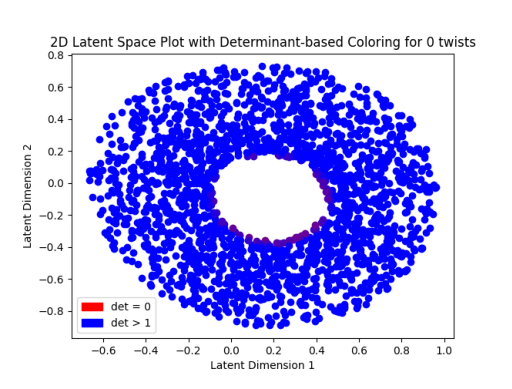

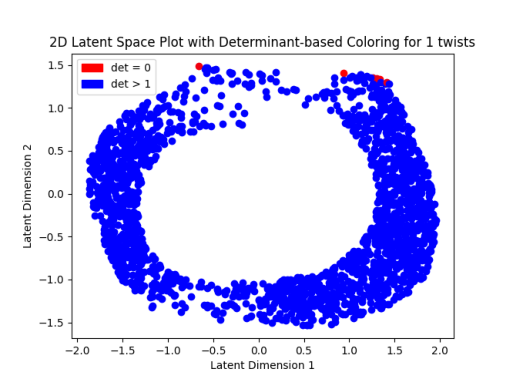

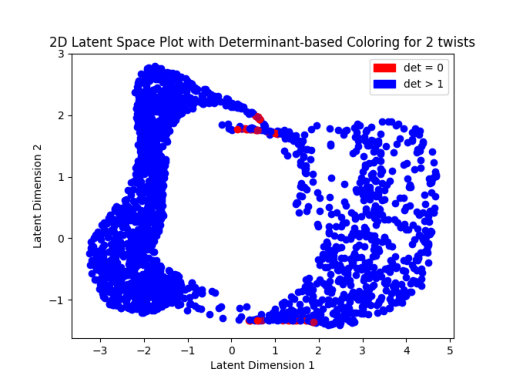

In [40]:
import os
import plotly.io as pio
import matplotlib.pyplot as plt
load_plots = True
save_plots = False 

# With 0 twists
file_path_2d = f'plots/_2d_plot_0_twists.png'
if save_plots == True:
    model_analysis = ModelAnalysis(best_models_list[0], X_0_test, Y_0_test, Z_0_test, S_0_test, T_0_test, twists=0)
    plt_ = model_analysis.plot()
    plt_.show()
    os.makedirs(os.path.dirname(file_path_2d), exist_ok=True)
    plt_.savefig(file_path_2d)

if load_plots == True:
    img = plt.imread(file_path_2d)
    plt.imshow(img)
    plt.axis('off')
    plt.show()

# With 0 twists 3d 
file_path_3d = f'plots/_3d_plot_0_twists.json'
if enable_3d_graphics :
    if save_plots == True:
        fig = model_analysis.plot_3d()
        fig.write_json(file_path_3d)
    if load_plots == True:
        fig = pio.read_json(file_path_3d)
        fig.show()

# With 1 twist
file_path_2d = f'plots/_2d_plot_1_twists.png'    
if save_plots == True:
    model_analysis = ModelAnalysis(best_models_list[1], X_1_test, Y_1_test, Z_1_test, S_1_test, T_1_test, twists=1)
    plt_ = model_analysis.plot()
    plt_.show()
    plt_.savefig(file_path_2d)

if load_plots == True:
    img = plt.imread(file_path_2d)
    plt.imshow(img)
    plt.axis('off')
    plt.show()

# With 1 twist 3d
file_path_3d = f'plots/_3d_plot_1_twists.json'
if enable_3d_graphics :
    if save_plots == True:
        fig = model_analysis.plot_3d()
        fig.write_json(file_path_3d)
    if load_plots == True:
        fig = pio.read_json(file_path_3d)
        fig.show()

# With 2 twists
file_path_2d = f'plots/_2d_plot_2_twists.png'
if save_plots == True:
    model_analysis = ModelAnalysis(best_models_list[2], X_2_test, Y_2_test, Z_2_test, S_2_test, T_2_test, twists=2)
    plt_ = model_analysis.plot()
    plt_.show()
    plt_.savefig(file_path_2d)
    
if load_plots == True:
    img = plt.imread(file_path_2d)
    plt.imshow(img)
    plt.axis('off')
    plt.show()

# With 2 twists 3d
file_path_3d = f'plots/_3d_plot_2_twists.json'

if enable_3d_graphics :
    if save_plots == True:
        fig = model_analysis.plot_3d()
        fig.write_json(file_path_3d)
    if load_plots == True:
        fig = pio.read_json(file_path_3d)
        fig.show()





We notice singularities in the embedding. We will now train a custom model approximating the parameterization and inverse parameterization functions.

# 4. Custom training function to avoid singularties 

In [41]:
# This class includes all needed functions, such as the inverse functions, or functions mapping too and from a Möbius strip and an annulus
class two_twist_Möbius_Functions(): 
    def __init__(self, r=0.5, r_möb=1):
        self.w = 1
        self.r = torch.tensor(r, dtype=torch.float64)
        self.k = torch.tensor(2, dtype=torch.float32)
        self.r_möb = r_möb
        

    ##### MOBIUS STRIP TO ANNULUS #####
    def s_inverse(self, x, y, z):  # inverse function for s
        return (x * z**2 + y * z) / y**2

    def t_inverse(self, x, y, z):  # inverse function t
        t = torch.atan2(y, x) / (2 * torch.tensor(np.pi))
        t = torch.where(t < 0, t + 1, t)
        return t

    def composition_Möbius_to_Annulus(self, x, y, z):
        f1_result = self.t_inverse(x, y, z)
        f2_result = self.s_inverse(x, y, z)
        psi_x_result = (self.r + f2_result+1) * torch.cos(f1_result * (2 * torch.tensor(np.pi)))
        psi_y_result = (self.r + f2_result+1) * torch.sin(f1_result * (2 * torch.tensor(np.pi)))
        return [psi_x_result, psi_y_result]

    ##### ANNULUS TO MOBIUS STRIP #####
    def annulus_to_square(self, x, y):
        t = torch.atan2(y, x) / (2 * torch.tensor(np.pi))
        t = torch.where(t < 0, t + 1, t)
        s = torch.sqrt(x**2 + y**2) - 1 + 0.5
        s = s - 1
        return t, s

    def parameterize_circle(self, t):
        t_size = t.size()
        zero_tensor = torch.zeros(t_size, dtype=torch.float32, device='cpu')
        return torch.stack([self.r_möb * torch.cos(torch.tensor(2 * np.pi) * t), self.r_möb * torch.sin(torch.tensor(2 * np.pi) * t), zero_tensor])

    def square_to_möbius(self, t, s):
        C_t = self.parameterize_circle(t)
        t_size = t.size()
        zero_tensor = torch.zeros(t_size, dtype=torch.float32, device='cpu')
        ones_tensor = torch.ones(t_size, dtype=torch.float32, device='cpu')
        e_3 = torch.stack((zero_tensor, zero_tensor, ones_tensor))
        R_ts = (s * torch.cos(self.k * torch.tensor(np.pi) * t)) * C_t + (s * torch.sin(self.k * torch.tensor(np.pi) * t)) * e_3 
        M_ts = C_t + R_ts
        return [M_ts[0], M_ts[1], M_ts[2]]

    def composition_Annulus_to_Möbius(self, x, y):
        t, s = self.annulus_to_square(x, y)
        return self.square_to_möbius(t, s)



In [42]:

#We will be using the high complexity model for this task
class Autoencoder_Custom_training(nn.Module):
    def __init__(self, latent_dim=2, input_dim=3):
        super(Autoencoder_Custom_training, self).__init__()
        self.encoder = nn.Sequential(
                    nn.Linear(input_dim, 128),
                    nn.Tanh(),
                    nn.Linear(128, 64),
                    nn.Tanh(),
                    nn.Linear(64, 32),
                    nn.Tanh(),
                    nn.Linear(32, 16),
                    nn.Tanh(),
                    nn.Linear(16, latent_dim),
                )
        self.decoder = nn.Sequential(
                    nn.Linear(latent_dim, 16),
                    nn.Tanh(),
                    nn.Linear(16, 32),
                    nn.Tanh(),
                    nn.Linear(32, 64),
                    nn.Tanh(),
                    nn.Linear(64, 128),
                    nn.Tanh(),
                    nn.Linear(128, input_dim),
                )

    def forward(self, x):
        x = self.encoder(x)
        x = self.decoder(x)
        return x
    def encode(self, x):
        return self.encoder(x)
    def decode(self, x):
        return self.decoder(x)

In [43]:


load_model = True
# Initialize the model
if load_model == False: 
    Autoencoder_Custom = Autoencoder_Custom_training(latent_dim, input_dim)
else: 
    Autoencoder_Custom = Autoencoder_Custom_training(latent_dim, input_dim)
    Autoencoder_Custom.load_state_dict(torch.load('saved_weights/Autoencoder_Custom_training.pt'))

möbius_to_annulus = two_twist_Möbius_Functions().composition_Möbius_to_Annulus
annulus_to_möbius = two_twist_Möbius_Functions().composition_Annulus_to_Möbius

# Generating extra data
L_2_x, L_2_y = möbius_to_annulus(X_2, Y_2, Z_2)
M_2_x, M_2_y, M_2_z = annulus_to_möbius(L_2_x, L_2_y)



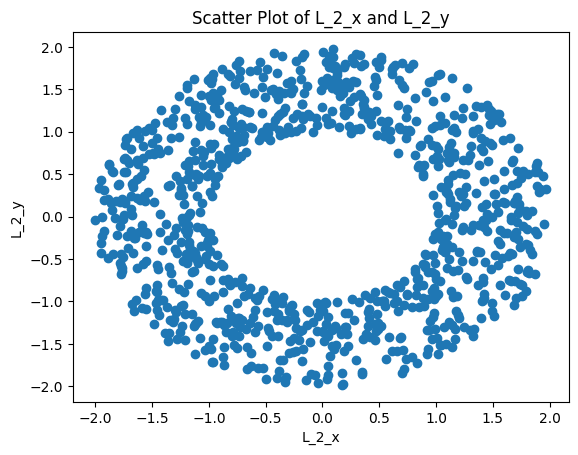

In [44]:
# Visualising L_2_x, L_2_y in a 2d scatter plot 
plt.scatter(L_2_x, L_2_y)
plt.xlabel('L_2_x')
plt.ylabel('L_2_y')
plt.title('Scatter Plot of L_2_x and L_2_y')
plt.show()


### Training the encoder 

In [45]:
# Training the model
n_epochs = 30000
lr = 0.0001  # Learning rate for Adam
beta1 = 0.9
beta2 = 0.99

# Ensure you use the correct optimizer for the correct model parameters
optimizer = optim.Adam(Autoencoder_Custom.encoder.parameters(), lr=lr, betas=(beta1, beta2))
criterion = nn.MSELoss()

if load_model == False:

    # Convert the data to torch tensors
    X_2 = torch.tensor(X_2, dtype=torch.float32)
    Y_2 = torch.tensor(Y_2, dtype=torch.float32)
    Z_2 = torch.tensor(Z_2, dtype=torch.float32)
    S_2 = torch.tensor(S_2, dtype=torch.float32)
    T_2 = torch.tensor(T_2, dtype=torch.float32)
    L_2_x = torch.tensor(L_2_x, dtype=torch.float32)
    L_2_y = torch.tensor(L_2_y, dtype=torch.float32)

    # Combine the data into a single tensor
    data = torch.stack((X_2, Y_2, Z_2), dim=1)
    latents = torch.stack((L_2_x, L_2_y), dim=1)

    # Training the model
    loss_values = []
    for epoch in range(n_epochs):
        optimizer.zero_grad()
        outputs = Autoencoder_Custom.encode(data)  # Only use the encoder
        loss = criterion(outputs, latents)
        loss.backward()
        optimizer.step()
        loss_values.append(loss.item())

        if epoch % 100 == 0:
            print(f'Epoch {epoch}, Loss: {loss.item()}')


We wee that this Custom encoder, indeed produces an embedding that has no large singularties. We wonder if this is stable under the learning methods used earlier. 

### We will now train the decoder

In [46]:

# Using L_2_x, L_2_y as input data
# Using comp_annulus_to_Möbius as the aim function 
# Using the annulus_encoder as the model


# Training the model
n_epochs = 30000
lr = 0.0001  # Learning rate for Adam
beta1 = 0.9
beta2 = 0.99

# Ensure you use the correct optimizer for the correct model parameters
optimizer = optim.Adam(Autoencoder_Custom.decoder.parameters(), lr=lr, betas=(beta1, beta2))
criterion = nn.MSELoss()

if load_model == False:

    # Convert the data to torch tensors
    X_2 = torch.tensor(X_2, dtype=torch.float32)
    Y_2 = torch.tensor(Y_2, dtype=torch.float32)
    Z_2 = torch.tensor(Z_2, dtype=torch.float32)
    S_2 = torch.tensor(S_2, dtype=torch.float32)
    T_2 = torch.tensor(T_2, dtype=torch.float32)
    L_2_x = torch.tensor(L_2_x, dtype=torch.float32)
    L_2_y = torch.tensor(L_2_y, dtype=torch.float32)

    # Combine the data into a single tensor
    data = torch.stack((L_2_x, L_2_y), dim=1)
    goals = torch.stack((X_2, Y_2,Z_2), dim=1)

    # Training the model
    loss_values = []
    for epoch in range(n_epochs):
        optimizer.zero_grad()
        outputs = Autoencoder_Custom.decode(data)  # Only use the encoder
        #print(outputs.shape)
        loss = criterion(outputs, goals)
        loss.backward()
        optimizer.step()
        loss_values.append(loss.item())

        if epoch % 100 == 0:
            print(f'Epoch {epoch}, Loss: {loss.item()}')
    #savine
    # Saving the model
    torch.save(Autoencoder_Custom.state_dict(), 'saved_weights/Autoencoder_Custom_training.pt')

In [47]:
# Evaluating the total model on the test set: 
import torch.nn.functional as F

data = torch.stack((X_2_test, Y_2_test, Z_2_test),dim = 1)
best_model_two_twists =  best_models_list[2]

outputs_best_model = best_model_two_twists.forward(data)
outputs_Custom_model = Autoencoder_Custom.forward(data)

mse_loss_best_model = F.mse_loss(data,outputs_best_model)
mse_loss_Custom_model = F.mse_loss(data,outputs_Custom_model)

print("mse_loss_best_model:", mse_loss_best_model)
print("mse_loss_Custom_model:", mse_loss_Custom_model)


if enable_3d_graphics:
    k = 2

    data = torch.stack((X_2, Y_2, Z_2), dim=1)
    reconstructed_data = Autoencoder_Custom(data).detach().numpy()

    fig = go.Figure(data=[
        go.Scatter3d(x=X_2, y=Y_2, z=Z_2, mode='markers', marker=dict(size=2), name='Original'),
        go.Scatter3d(x=reconstructed_data[:, 0], y=reconstructed_data[:, 1], z=reconstructed_data[:, 2],
                    mode='markers', marker=dict(size=2), name='Reconstructed')
    ])

    fig.update_layout(
        title=f'Best model, {k} twists',
        scene=dict(
            aspectmode='manual',
            aspectratio=dict(x=1, y=1, z=1),
            zaxis=dict(range=[-1, 1])  # Ensure z-axis is between -1 and 1
        )
    )

    fig.show()



mse_loss_best_model: tensor(0.0015, grad_fn=<MseLossBackward0>)
mse_loss_Custom_model: tensor(7.5196e-06, grad_fn=<MseLossBackward0>)


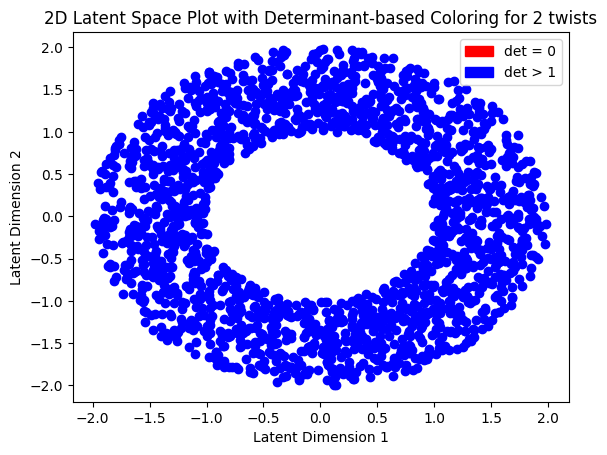

In [48]:
# Checking for singularites 
model_analysis = ModelAnalysis(Autoencoder_Custom, X_2_test, Y_2_test, Z_2_test, S_2_test, T_2_test, twists=2)
model_analysis.plot()
if enable_3d_graphics:
    model_analysis.plot_3d()


So we see that the custom model is indeed better than any model where no restriction on how the latent space should look like was imposed. Also, we see that the custom model has no singularities, i.e., we have achieved a "nice" embedding of the doubly twisted Möbius strip.

# 5. Stabilty of Graident descent 

As a final step we wish to analyse if the training the Custom model with no restrictions is stable. 

In [49]:


# Define adam optimizer
optimizer = optim.Adam(Autoencoder_Custom.parameters(), lr=0.01, betas=(0.9, 0.99))
further_train_model = False #change_me
# def train_autoencoder(model, X, Y, Z, n_epochs, lr, momentum):
# train_autoencoder(model, X, Y, Z, n_epochs, optimizer, device = 'cpu'):
if further_train_model:
    further_trained_Autoencoder_Custom = copy.deepcopy(Autoencoder_Custom)
    train_autoencoder(further_trained_Autoencoder_Custom,X_2,Y_2,Z_2, n_epochs = 30000, optimizer = optimizer, device = 'cpu')
    #Saving
    torch.save(further_trained_Autoencoder_Custom.state_dict(), 'saved_weights/further_trained_Autoencoder_Custom.pt')

else:
    further_trained_Autoencoder_Custom = copy.deepcopy(Autoencoder_Custom)
    further_trained_Autoencoder_Custom.load_state_dict(torch.load('saved_weights/further_trained_Autoencoder_Custom.pt'))

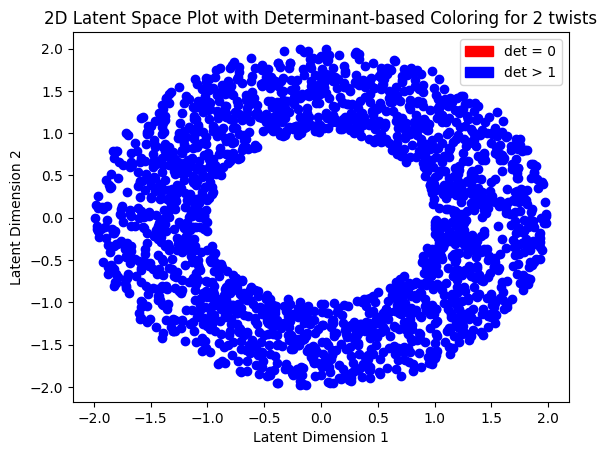

In [50]:
### Checking for singularites again

# Using modelanalysis 


# With 0 twists
model_analysis = ModelAnalysis(further_trained_Autoencoder_Custom, X_2_test, Y_2_test, Z_2_test, S_2_test, T_2_test, twists=2)
model_analysis.plot()
if enable_3d_graphics:
    model_analysis.plot_3d()


We indeed see stabilty. 

# 6. Different loss functions

# Calculation of immersion loss 

While not used in training the model, we will calculate the immersion loss and bottleneck loss. 

In [51]:
#class ModelAnalysis: 
#    def __init__(self, model, X_test, Y_test, Z_test, S_test, T_test, twists=2): 

# using ModelAnalysis
model_analysis_2_twisted = ModelAnalysis(best_models_list[2], X_2_test, Y_2_test, Z_2_test, S_2_test, T_2_test, twists=2)
model_analysis_further_trained_custom = ModelAnalysis(further_trained_Autoencoder_Custom, X_2_test, Y_2_test, Z_2_test, S_2_test, T_2_test, twists=2)


In [52]:

def immersion_loss(mode_analysis_instance, X_2_test, Y_2_test, Z_2_test):

    loss = 0
    for i in range(len(X_2_test)):
        determinant = mode_analysis_instance.determinants[i]
        #loss += (1 - tanh(det( differential( e o phi_inverse(x))) )^2)
        loss = loss + (1 - torch.tanh( determinant)**2)
    #printing the loss as a float 
    print(float(loss))

print("Immersion loss of naively trained model: ")
immersion_loss(model_analysis_2_twisted, X_2_test, Y_2_test, Z_2_test)
print("Immersion loss of customly trained model: ")
immersion_loss(model_analysis_further_trained_custom, X_2_test, Y_2_test, Z_2_test)


Immersion loss of naively trained model: 
63.07856369018555
Immersion loss of customly trained model: 
0.011522650718688965


# Calculation of bottleneck-distance loss 

In [54]:
from ripser import ripser
from persim import bottleneck
def compute_barcode(data_points):
    # Compute the persistent homology
    result = ripser(data_points)
    # Extract the barcodes (persistence diagrams)
    diagrams = result['dgms']
    return diagrams


def bottleneck_distance_loss(X, Y, Z, encoder):

    data_points = torch.stack((X, Y, Z), dim=1)
    latents = encoder(data_points)

    # Compute barcodes for original and encoded data
    barcode_original = compute_barcode(data_points)
    barcode_encoded = compute_barcode(latents.detach().numpy())

    # Compute bottleneck distances for each dimension
    bdists = []
    for dim in range(len(barcode_original)):
        D1 = barcode_original[dim]
        D2 = barcode_encoded[dim]
        bdist = bottleneck(D1, D2)
        bdists.append(bdist)

    # Sum the bottleneck distances to compute the loss
    loss = sum(bdists)
    return loss





do_computation = False # Computing the bottleneck distance takes a few mins 

if do_computation == True:
    print("Bottleneck distance loss of naively trained model: ")
    print(bottleneck_distance_loss(X_2, Y_2, Z_2, best_models_list[2].encoder))
    print("Bottleneck distance loss of customly trained model: ")
    print(bottleneck_distance_loss(X_2, Y_2, Z_2, Autoencoder_Custom.encode))





# 7. Why does the Autoencoder not converge to an embedding?

In [55]:
# Using model low complexity 2 twists
#best model
model_test = best_models_list[2]


#Finding a singularity point in the embedding space using model_analysis
model_analysis = ModelAnalysis(model_test, X_2_test, Y_2_test, Z_2_test, S_2_test, T_2_test, twists=2, use_upper_singularity_point = True)
#fig = model_analysis.plot()
singularity_point, singularity_point_latent = model_analysis.get_singularity_point()
print("singularity point origin: ", singularity_point)
print("singularity point in latent space: ",singularity_point_latent )

lowest_det_value:  tensor(0.0468)
singularity point origin:  tensor([0.6412, 0.9894, 0.2762])
singularity point in latent space:  tensor([0.3539, 1.7779], grad_fn=<SelectBackward0>)


In [56]:

#singularity point origin:  tensor([0.6412, 0.9894, 0.2762])
#singularity point in latent space:  tensor([0.3539, 1.7779],



eps = 0.02
linspace_len = 80
buckets_len = 8



angle_linspace = torch.linspace(0, 2 * torch.pi, linspace_len)
radius_lin_space = torch.linspace(eps - eps / 10, eps + eps / 10, 10)



def polar_coordinates(phi,psi):
    #returnes a point on the unit ball in R^3 as a torch tensor 
    x = torch.sin(phi) * torch.cos(psi)
    y = torch.sin(phi) * torch.sin(psi)
    z = torch.cos(phi)
    
    return torch.tensor([x, y, z], dtype=torch.float32)


def dist(a,b):
    #computes distance between two points 
    return torch.linalg.norm(a-b)

perturbed_inputs = []
perturbed_latents = []
angles = []
buckets = np.zeros((linspace_len,linspace_len) )

buckets_only_latent =  np.zeros(buckets_len)

for i, phi in enumerate(angle_linspace):
    for j, psi in enumerate(angle_linspace):
        for radius in radius_lin_space:
            
            perturbed_point = singularity_point + radius*polar_coordinates(phi,psi)
            # computing pertubed latents 
            perturbed_point_latent = model_test.encoder(perturbed_point)
            if (dist(singularity_point_latent,perturbed_point_latent) - eps ) < 0.01:
                perturbed_latents.append(perturbed_point_latent)    
                perturbed_inputs.append(perturbed_point)
                angles.append([phi,psi])

                decoder_output = model_test.decoder(perturbed_point_latent)
                loss_value = torch.norm(decoder_output - singularity_point)
                buckets[i,j] = loss_value

                angle_in_latent_space = torch.atan2( singularity_point_latent[1] - perturbed_point_latent[1], singularity_point_latent[0] - perturbed_point_latent[0])

                index = round(float( angle_in_latent_space/(2*torch.pi) * buckets_len ))
                buckets_only_latent[index] = loss_value

loss_no_pertubation = float(torch.norm(model_test.decoder(singularity_point_latent) - singularity_point).item())

print(buckets_only_latent)
print("loss_no_pertubation: ", loss_no_pertubation)

[0.12507623 0.12998036 0.12997334 0.13208005 0.13520369 0.1341909
 0.13510339 0.12956613]
loss_no_pertubation:  0.13287702202796936


In [57]:
# Plotting buckets_only_latent using ploty.

import plotly.graph_objects as go

# x axis angle from 0 to 2pi
# y axis value of buckets_only_latent

fig = go.Figure(data=go.Scatter(x=np.linspace(0, 7*np.pi/4, buckets_len), y=buckets_only_latent, mode='lines+markers'))
fig.update_layout(title='L2-Loss of Perturbed Singularity Point', xaxis_title='Angle', yaxis_title='L2-Loss')

#Add a line for the loss of the singularity point without pertubation
fig.add_shape(type="line",
    x0=0, y0=loss_no_pertubation, x1=7*np.pi/4, y1=loss_no_pertubation,
    line=dict(color="Red",width=2)
)

#changing font to times new roman 
fig.update_layout(
    font=dict(
        family="Times New Roman",
        size=18,
        color="Black"
    )
)

# fix tick marks of as multiples of pi/2
fig.update_xaxes(tickvals=[0, np.pi/4, np.pi/2, 3*np.pi/4, np.pi, 5*np.pi/4, 3*np.pi/2, 7*np.pi/4], ticktext=['0', 'π/4', 'π/2', '3π/4', 'π', '5π/4', '3π/2', '7π/4'])
fig.show()


In [58]:
#singularity point origin:  tensor([0.6412, 0.9894, 0.2762])
#singularity point in latent space:  tensor([0.3539, 1.7779],
